In [26]:
import numpy as np
import tifffile


arr = np.zeros((512, 512))
center = (256, 256)
box_size = (100, 100)
top_left = (center[0] - box_size[0]//2, center[1] - box_size[1]//2)
bottom_right = (center[0] + box_size[0]//2, center[1] + box_size[1]//2)

arr[top_left[0]:bottom_right[0], top_left[1]:bottom_right[1]] = 1

img = tifffile.imread('/Users/domchom/Documents/GitHub/Dom_python_scripts/wound_close_quant/movies/trimmed.tif')
img = img[0][0]

nonzero_indices = np.where(img != 0)
center_of_mass = (np.mean(nonzero_indices[0]), np.mean(nonzero_indices[1]))
print(center_of_mass)
print(img.shape)
center_of_mass = [277,250]


TiffPage 0: TypeError: read_bytes() missing 3 required positional arguments: 'dtype', 'count', and 'offsetsize'


(255.5, 255.5)
(512, 512)


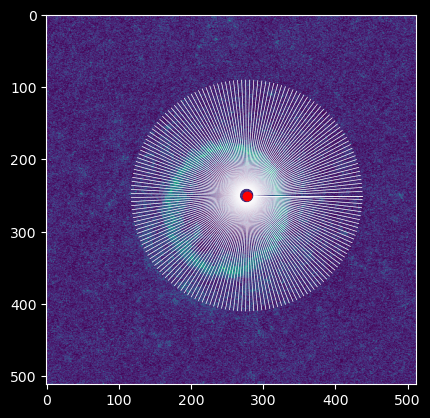

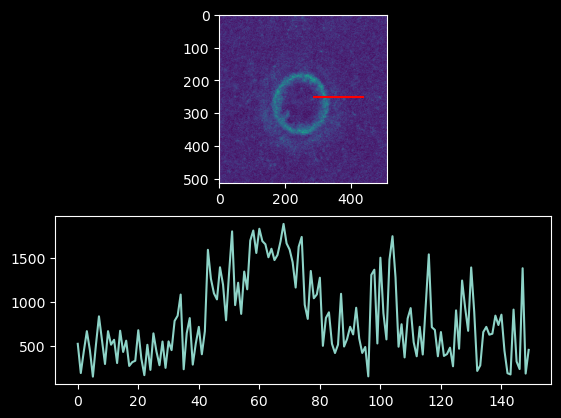

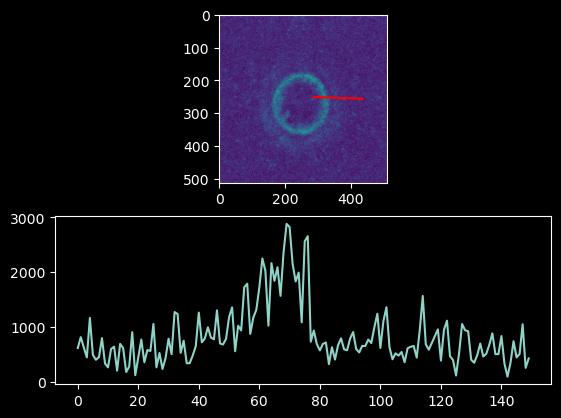

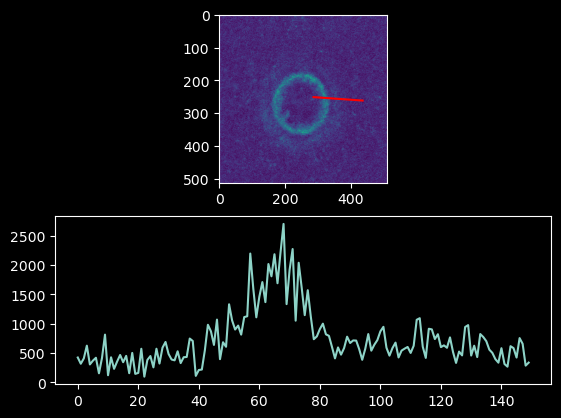

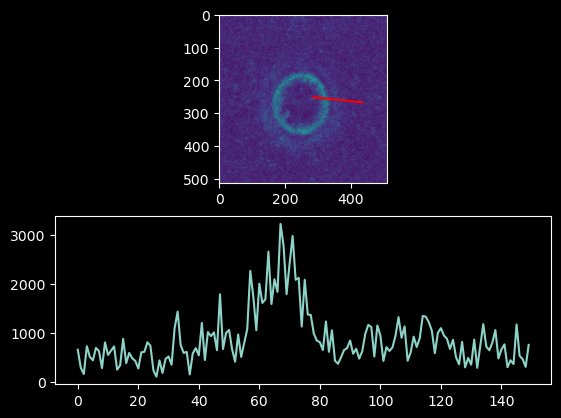

...

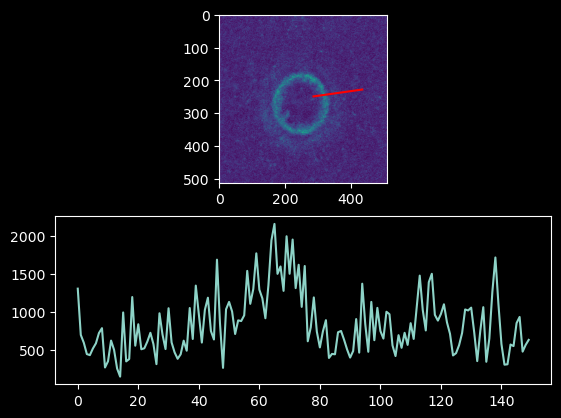

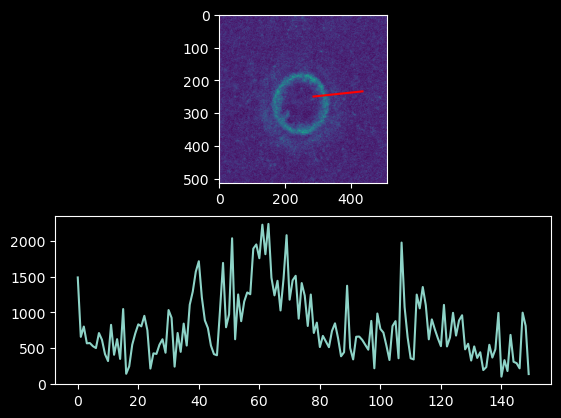

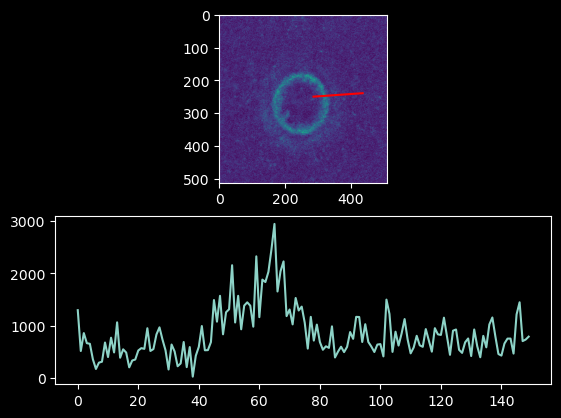

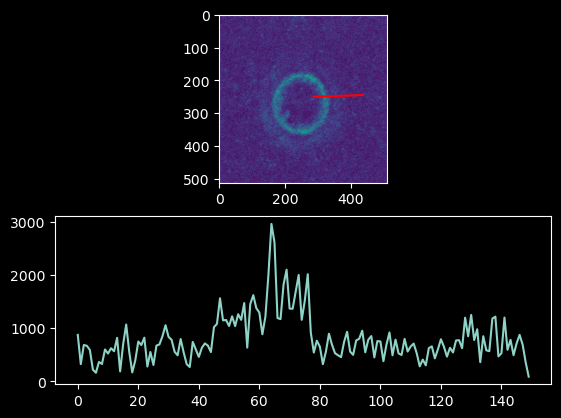

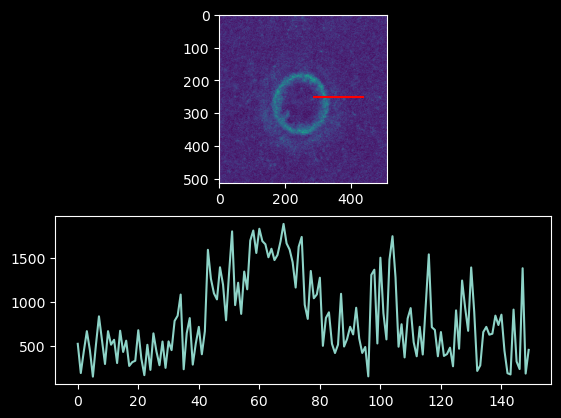

array([[[[ 526,  193,  442, ..., 1387,  187,  457],
         [ 615,  814,  625, ..., 1049,  253,  425],
         [ 424,  318,  409, ...,  658,  286,  337],
         ...,
         [1295,  513,  856, ...,  703,  732,  788],
         [ 874,  324,  684, ...,  692,  361,   90],
         [ 526,  193,  442, ..., 1387,  187,  457]]]], dtype=uint16)

In [27]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
import pyclesperanto_prototype as cle
import tifffile
import scipy 
import skimage
import imageio.v2 as imageio
import os 
import glob
import logging
import napari
from datetime import datetime

num_lines = 180 #how many line scans per frame

line_length = 150
line_length = 150 #choose you line length
bin_num = 150 #number of data points per line

def create_lines(center, ellipse_ratio):
    '''creates lines in an ellipital shape with a given center. It creates
    two ellipses and iterates over the larger ellipse to find the closest points on the smaller ellipse.'''
    # Define the two ellipses
    small_ellipse_width = 20
    small_ellipse_height = small_ellipse_width * ellipse_ratio
    large_ellipse_width = line_length * 2 + small_ellipse_width
    large_ellipse_height = line_length * 2 + small_ellipse_height

    small_ellipse = Ellipse(xy=(center[0], center[1]), width=small_ellipse_width, height=small_ellipse_height, angle=0)
    large_ellipse = Ellipse(xy=(center[0], center[1]), width=large_ellipse_width, height=large_ellipse_height, angle=0)

    # Check if small ellipse is inside large ellipse
    if large_ellipse.contains_point(small_ellipse.center):
        
        # Create an array of points on the large ellipse
        theta = np.linspace(0, 2 * np.pi, num_lines)
        points = np.stack([large_ellipse.center[0] + large_ellipse.width/2*np.cos(theta), 
                        large_ellipse.center[1] + large_ellipse.height/2*np.sin(theta)], axis=1)

        # Loop over each point on the large ellipse and calculate the shortest distance to the small ellipse and line segment
        line_coords = [[np.linspace(x0, x1, bin_num), np.linspace(y0, y1, bin_num)] 
                    for i, point in enumerate(points) 
                    if (distance := np.linalg.norm(small_ellipse.center - point) - small_ellipse_width / 2) >= 0
                    for theta in [np.arctan2(point[1] - large_ellipse.center[1], point[0] - large_ellipse.center[0])]
                    for x0, y0, x1, y1 in [[point[0], point[1], 
                                            small_ellipse.center[0] + small_ellipse_width / 2 * np.cos(theta), 
                                            small_ellipse.center[1] + small_ellipse_height / 2 * np.sin(theta)]]]
    
    return line_coords
        
def return_line_ref_figure(img, line_coords, center):
    # Plot the ellipses and lines
    fig, ax = plt.subplots()
    for coords in line_coords:
        ax.plot(coords[0], coords[1], 'w-', linewidth=0.5)
    ax.plot(center[0], center[1], 'ro')
    ax.set_aspect('equal', adjustable='box')
    ax.imshow(img)    
    fig.subplots_adjust(hspace=0.5)
    return fig

def calc_line_scans(img, num_frames, num_channels, line_coords):
    """
    Calculates the signal along each line in each frame of an image stack.

    Args:
        img (ndarray): A 3D numpy array of shape (num_frames, num_channels, image_shape).
        num_frames (int): The number of frames in the image stack.
        num_channels (int): The number of channels in the image stack.
        line_coords (list): A list of line coordinates, where each line is a list of x and y coordinates.

    Returns:
        list: A list of channels, frames, where each frame is a list of signals, where each signal is an array of signal values.
    """
    channels_list = []


    for c in range(num_channels): #iterate over the channels
        frames_list = [] # store all the signals for every frame

        for f in range(num_frames): #iterate over the frames
            signals_list = [] #lost to store the signal for each line for the frame
            i = 0
            for line in line_coords: #create each line for each frame
                x, y = line[0], line[1]

                if np.all(abs(center - x[-1]) < abs(center - x[0])):
                    x = x[::-1]
                    x0, x1 = x[-1], x[0]
                else:
                    x = x
                    x0, x1 = x[0], x[-1]

                if np.all(abs(center - y[-1]) < abs(center - y[0])):
                    y = y[::-1]
                    y0, y1 = y[-1], y[0]
                else:
                   y = y
                   y0, y1 = y[0], y[-1]

                # Extract the values along the line, using cubic interpolation
                signal = scipy.ndimage.map_coordinates(img, np.vstack((x,y)))
                signals_list.append(signal)

                plot_idv_lines(img,signal,f,c,x0,x1,y0,y1,i)

            frames_list.append(signals_list)

        channels_list.append(frames_list)
    
    line_values_array = np.array(channels_list)

    return line_values_array

def calculate_mean_values(array):
    '''
    Iterates over each frame of a np array containing (num_channels, num_frames, num_lines in frame, num_bins in line).
    Averages each correspnding pixel on the line for each frame, and then returns a np
    array that contains (num_frames, one line in frame, num_bins in line)
    '''
    mean_values_all_ch = []

    for channel in array:
        bin_num = channel.shape[-1]
        mean_values = []
        for frame in channel:
            pixel_avg_per_frame = []
            for n in range(bin_num):
                pixel_avg_per_frame.append(frame[:,n].mean())
            mean_values.append(pixel_avg_per_frame)
        mean_values_all_ch.append(mean_values)

    mean_values_all_ch = np.array(mean_values_all_ch)

    return mean_values_all_ch

def plot_idv_lines(img,signal,f,c,x0,x1,y0,y1,i):
    
    plt.style.use('dark_background')
    fig, axes = plt.subplots(nrows=2)
    axes[0].imshow(img)
    axes[0].plot([x0, x1], [y0, y1], 'r-')
    axes[0].axis('image')

    axes[1].plot(signal)
    plt.show()

line_coords = create_lines(center_of_mass, 1)
return_line_ref_figure(img, line_coords, center_of_mass)
calc_line_scans(img, 1, 1, line_coords)


